In [1]:
# Importing and starting a spark session
from pyspark.sql import SparkSession
from pyspark import SparkContext
#Supress warnings
spark = SparkSession.builder.getOrCreate()
sc = SparkContext.getOrCreate()
sc.setLogLevel('WARN')

spark.conf.set('spark.sql.execution.arrow.pyspark.enabled', True)
#Make the spark files present well
spark.conf.set('spark.sql.repl.eagerEval.enabled', True)

21/08/16 07:42:59 WARN Utils: Your hostname, LAPTOP-D5HGLKLK resolves to a loopback address: 127.0.1.1; using 172.24.115.150 instead (on interface eth0)
21/08/16 07:42:59 WARN Utils: Set SPARK_LOCAL_IP if you need to bind to another address
21/08/16 07:43:01 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable
Using Spark's default log4j profile: org/apache/spark/log4j-defaults.properties
Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).
21/08/16 07:43:03 WARN Utils: Service 'SparkUI' could not bind on port 4040. Attempting port 4041.


In [2]:
#import taxi zones and nta data
import geopandas as gpd
taxi_zones = gpd.read_file('../raw_data_lite/taxi_zones.geojson')
tracts = gpd.read_file('../raw_data_lite/tracts.geojson')



/home/binhducvu/jupyterenv/lib/python3.8/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.1-CAPI-1.14.2). Conversions between both will be slow.
  warnings.warn(


In [3]:
#plot the taxi zone availability
import folium

taxi_zones_map = folium.Map(location=[40.66, -73.94], tiles="Stamen Terrain", zoom_start=10, control = True)

taxi_zones_map.add_child(folium.Choropleth(geo_data=taxi_zones, fill_color = 'green', name='choropleth'))

taxi_zones_map.save('../plots/taxi_zones_map.html')
taxi_zones_map

In [4]:
#plot the tracts availability

tracts_map = folium.Map(location=[40.66, -73.94], tiles="Stamen Terrain", zoom_start=10, control = True)

tracts_map.add_child(folium.Choropleth(geo_data=tracts, fill_color = 'pink', name='choropleth'))

tracts_map.save('../plots/tracts_map.html')
tracts_map

In [5]:
#merging the taxi zones and the NTA into a new dataframe
merged_zones = gpd.overlay(tracts, taxi_zones, how = 'intersection')
merged_zones

#some tracts overlap multiple zones - so we will allocate the tract to the zone with the most overlap

,CTLabel,BoroCode,BoroName,CT2010,BoroCT2010,CDEligibil,NTACode,NTAName,PUMA,Shape_Leng_1,Shape_Area_1,OBJECTID,Shape_Leng_2,Shape_Area_2,zone,LocationID,borough,geometry
0,9,5,Staten Island,000900,5000900,E,SI22,West New Brighton-New Brighton-St. George,3903,7729.016794,2.497010e+06,206,0.212757,0.000944,Saint George/New Brighton,206,Staten Island,"POLYGON ((962288.722 173671.642, 962548.443 17..."
1,11,5,Staten Island,001100,5001100,E,SI22,West New Brighton-New Brighton-St. George,3903,8675.079203,3.496830e+06,206,0.212757,0.000944,Saint George/New Brighton,206,Staten Island,"POLYGON ((962365.893 171820.514, 962349.083 17..."
2,105,5,Staten Island,010500,5010500,I,SI35,New Brighton-Silver Lake,3903,12556.270765,8.794153e+06,206,0.212757,0.000944,Saint George/New Brighton,206,Staten Island,"MULTIPOLYGON (((951955.443 168763.699, 951971...."
3,133.01,5,Staten Island,013301,5013301,E,SI22,West New Brighton-New Brighton-St. George,3903,3426.122011,7.213333e+05,206,0.212757,0.000944,Saint George/New Brighton,206,Staten Island,"POLYGON ((951551.353 170471.268, 951524.833 17..."
4,121,5,Staten Island,012100,5012100,I,SI35,New Brighton-Silver Lake,3903,11138.026898,7.991818e+06,206,0.212757,0.000944,Saint George/New Brighton,206,Staten Island,"MULTIPOLYGON (((952622.450 166757.276, 952615...."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4977,1072.02,4,Queens,107202,4107202,I,QN99,park-cemetery-etc-Queens,4114,180931.706177,7.063426e+07,30,0.094510,0.000146,Broad Channel,30,Queens,"MULTIPOLYGON (((1033136.923 157516.520, 103311..."
4978,516,2,Bronx,051600,2051600,I,BX10,Pelham Bay-Country Club-City Island,3703,93905.199852,1.736905e+07,46,0.134475,0.000926,City Island,46,Bronx,"MULTIPOLYGON (((1042787.709 243673.921, 104282..."
4979,5,1,Manhattan,000500,1000500,I,MN99,park-cemetery-etc-Manhattan,3810,32642.083856,9.083214e+06,105,0.077425,0.000369,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((979978.435 191779.634, 979978.435 19..."
4980,1,2,Bronx,000100,2000100,I,BX98,Rikers Island,3710,18897.487562,1.816374e+07,199,0.077809,0.000289,Rikers Island,199,Bronx,"POLYGON ((1019451.101 225649.808, 1019424.485 ..."


In [6]:
# filter out redundant columns
merged_zones = merged_zones.filter(['BoroCT2010', 'zone', 'LocationID', 'geometry'], axis = 1)
# create area column
merged_zones['area'] = merged_zones.geometry.area

#in cases where a tract overlaps more than one zone, remove all except the one with max overlap area.
merged_zones.sort_values(by='area', inplace=True)
merged_zones.drop_duplicates(subset='BoroCT2010', keep='last', inplace=True)

In [7]:
#create a dictionary for converting from tract code to taxi zone
tracts_to_zones = {}
for index, row in merged_zones.iterrows():
    tracts_to_zones[row['BoroCT2010']] = row['LocationID']

In [8]:
taxi_2018 = spark.read.parquet('../preprocessed_data/preprocessed_taxi_2018.parquet')

In [9]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [10]:
# generate a sample from the df for visualisation
# code only run once, as the sample is then saved and reused for consistency
#sample_data = taxi_2018.sample(0.001)
#sample_data = sample_data.toPandas()

In [11]:
#sample_data.to_csv('../data/sample_data.csv')

In [12]:
#read sampled data
sample_data = pd.read_csv('../data/sample_data.csv')
sample_data.tip_amount.describe()

count    69938.000000
mean         2.634941
std          2.393123
min          0.000000
25%          1.260000
50%          2.000000
75%          3.000000
max         70.090000
Name: tip_amount, dtype: float64

/home/binhducvu/jupyterenv/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/binhducvu/jupyterenv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='tip_amount', ylabel='Density'>

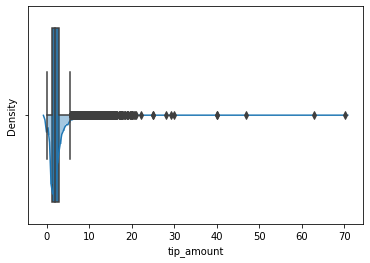

In [13]:
#preliminarily plotting tip amounts
sns.distplot(sample_data['tip_amount'], bins=100)
sns.boxplot(sample_data['tip_amount'])

/home/binhducvu/jupyterenv/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


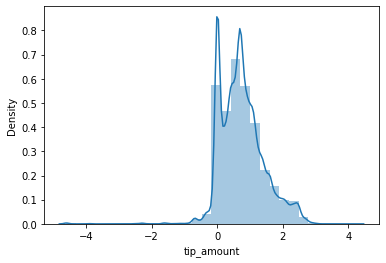

In [14]:
from numpy import log, sqrt

# apply a log transformation for all x non-zero x points, else 0
def logify(x):
    return log(x) if x else 0

sns.distplot(sample_data['tip_amount'].apply(logify), bins=30)
plt.show()


In [15]:
from pyspark.sql.functions import *
# make dataframe for tip amount of all trips
all_tip_data = taxi_2018.groupBy('PULocationID') \
                            .agg(mean('tip_amount').alias('mean_tip_amount'),
                                mean('fare_amount').alias('mean_fare_amount'))
# make data frame for tip amount of tipped trips
only_tipped_data = taxi_2018.filter(taxi_2018.tip_amount > 0) \
                                   .groupBy('PULocationID') \
                                   .agg(mean('tip_amount').alias('mean_tip_amount'),
                                        mean('fare_amount').alias('mean_fare_amount'),
                                        count('PULocationID').alias('tipped_trips'))
                       
# make dataframe for count of untipped trips                       
untipped_data = taxi_2018.filter(taxi_2018.tip_amount == 0) \
           .groupBy('PULocationID').count().alias('untipped_trips')
only_tipped_data

PULocationID,mean_tip_amount,mean_fare_amount,tipped_trips
148,2.589515108104664,12.467396322491814,934002
243,3.8467187499999986,18.54987804878049,7872
31,5.959931034482757,30.989655172413794,145
137,2.2080976723654073,10.487903877267279,878918
85,3.929234375,20.373124999999998,640
251,7.038421052631579,14.973684210526315,38
65,3.2261236098683397,15.642525246069283,78230
255,2.856002953185968,13.414075848664286,66369
53,6.722962962962961,32.1005291005291,189
133,3.755661953727506,18.47514138817481,1556


In [16]:
import numpy as np
only_tipped_data = only_tipped_data.toPandas()
untipped_data = untipped_data.toPandas()
all_tip_data = all_tip_data.toPandas()

#merge dataframes for compiling percentages
only_tipped_data = pd.merge(only_tipped_data, untipped_data, on = 'PULocationID', how = 'outer')
only_tipped_data

,PULocationID,mean_tip_amount,mean_fare_amount,tipped_trips,count
0,148,2.589515,12.467396,934002,57926.0
1,243,3.846719,18.549878,7872,2691.0
2,31,5.959931,30.989655,145,100.0
3,137,2.208098,10.487904,878918,52699.0
4,85,3.929234,20.373125,640,1748.0
...,...,...,...,...,...
255,134,8.059095,37.307979,2509,1316.0
256,208,5.578024,29.030242,248,893.0
257,36,3.381693,15.745494,5382,1476.0
258,187,4.788182,23.113636,22,48.0


In [17]:
import math

#generate columns for scoring metrics
all_tip_data['tip_proportion'] = (all_tip_data['mean_tip_amount']
                           / all_tip_data['mean_fare_amount'])
only_tipped_data['tip_proportion'] = (only_tipped_data['mean_tip_amount']
                                / only_tipped_data['mean_fare_amount'])
only_tipped_data['untipped_rate'] = (only_tipped_data['count'] 
                                          / (only_tipped_data['tipped_trips']
                                          + only_tipped_data['count']))
only_tipped_data.replace(np.nan, 0)




,PULocationID,mean_tip_amount,mean_fare_amount,tipped_trips,count,tip_proportion,untipped_rate
0,148,2.589515,12.467396,934002,57926.0,0.207703,0.058397
1,243,3.846719,18.549878,7872,2691.0,0.207372,0.254757
2,31,5.959931,30.989655,145,100.0,0.192320,0.408163
3,137,2.208098,10.487904,878918,52699.0,0.210538,0.056567
4,85,3.929234,20.373125,640,1748.0,0.192864,0.731993
...,...,...,...,...,...,...,...
255,134,8.059095,37.307979,2509,1316.0,0.216015,0.344052
256,208,5.578024,29.030242,248,893.0,0.192145,0.782647
257,36,3.381693,15.745494,5382,1476.0,0.214772,0.215223
258,187,4.788182,23.113636,22,48.0,0.207158,0.685714


In [18]:
#plot tip proportion for all trips
all_tip_proportion = folium.Map(location=[40.66, -74.1], tiles="Stamen Terrain", zoom_start=10, control = True)

all_tip_proportion.add_child(folium.Choropleth(geo_data=taxi_zones, data = all_tip_data, 
                                            columns = ['PULocationID', 'tip_proportion'],
                                            key_on = 'properties.LocationID',
                                            fill_color = 'OrRd', name='choropleth'))

all_tip_proportion.save('../plots/all_tip_proportion.html')
all_tip_proportion

In [19]:
#plot tip proportion for tipped trips only

tip_proportion = folium.Map(location=[40.66, -74.1], tiles="Stamen Terrain", zoom_start=10, control = True)

tip_proportion.add_child(folium.Choropleth(geo_data=taxi_zones, data = only_tipped_data, 
                                            columns = ['PULocationID', 'tip_proportion'],
                                            key_on = 'properties.LocationID',
                                            fill_color = 'OrRd', name='choropleth'))

tip_proportion.save('../plots/tip_proportion.html')
tip_proportion

In [20]:
untipped_rate = folium.Map(location=[40.66, -74.1], tiles="Stamen Terrain", zoom_start=10, control = True)

untipped_rate.add_child(folium.Choropleth(geo_data=taxi_zones, data = only_tipped_data, 
                                            columns = ['PULocationID', 'untipped_rate'],
                                            key_on = 'properties.LocationID',
                                            fill_color = 'OrRd', name='choropleth'))

untipped_rate.save('../plots/untipped_rate.html')
untipped_rate

In [21]:
#explore tipping proportion outliers
only_tipped_data[only_tipped_data['tip_proportion'] > 0.3]

,PULocationID,mean_tip_amount,mean_fare_amount,tipped_trips,count,tip_proportion,untipped_rate
5,251,7.038421,14.973684,38,26.0,0.470053,0.406250
28,44,27.286667,54.716667,6,21.0,0.498690,0.777778
29,253,7.815914,25.172043,93,45.0,0.310500,0.326087
132,23,14.807895,38.043421,38,124.0,0.389237,0.765432
141,84,10.728333,31.383333,6,9.0,0.341848,0.600000
144,171,7.381949,24.223827,277,766.0,0.304739,0.734420


In [22]:
#exploring zone ID outliers
taxi_zones.loc[taxi_zones['LocationID'] == 103]

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry
102,103,0.014306,0.000006,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((972079.575 190732.429, 972184.766 19..."
103,104,0.021221,0.000012,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((973172.666 194632.348, 973310.630 19..."
104,105,0.077425,0.000369,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((979605.759 191880.575, 979978.435 19..."


This appears to be the cause of the data going unlabelled.

In [23]:
#creating a new column for whether a trip is tipped or not, int cast for easy handling in plots
taxi_2018 = taxi_2018.withColumn('tipped', (taxi_2018.tip_amount > 0).cast('int'))


## Time as a factor

In [24]:
from pyspark.sql.functions import *

#tipped = 1, untipped = 0 so tip rate is just mean(tipped)
month_grouping = taxi_2018.groupBy(month(taxi_2018.pickup_time).alias('month')) \
                                  .agg(mean('tipped').alias('tip_rate'))

#set to pandas for plotting
month_grouping = month_grouping.toPandas()
month_grouping

,month,tip_rate
0,12,0.952689
1,1,0.961365
2,6,0.951537
3,3,0.955801
4,5,0.953485
5,9,0.948464
6,4,0.955883
7,8,0.946953
8,7,0.948431
9,10,0.949532


<AxesSubplot:xlabel='month', ylabel='tip_rate'>

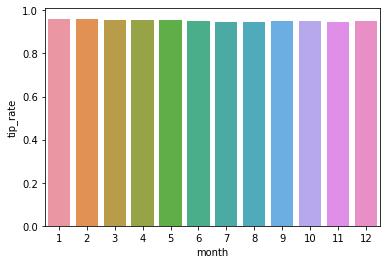

In [25]:


month_tip_rate = sns.barplot(x = 'month', y='tip_rate', data = month_grouping)

month_tip_rate


In [26]:
#grouping data by weekday/weekend (weekend = True)
weekend_grouping = taxi_2018.groupBy(dayofweek('pickup_time').isin([1, 7]).alias('weekend'))\
                                    .agg(mean('tipped').alias('tip_rate'))
weekend_grouping = weekend_grouping.toPandas()

weekend_grouping

,weekend,tip_rate
0,True,0.947632
1,False,0.954693


<AxesSubplot:xlabel='weekend', ylabel='tip_rate'>

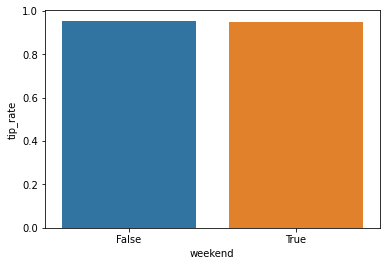

In [27]:
#plot weekend tip rate data
weekend_tip_rate = sns.barplot(x = 'weekend', y='tip_rate', data = weekend_grouping)
weekend_tip_rate


## Trip Duration and Distance as a factor

In [28]:
# create a pearson correlation matrix for trip duration and distance
sample_data['tipped'] = sample_data['tip_amount'] > 0
sample_data['tipped'] = sample_data['tipped'].astype(int)

sample_data[['trip_distance', 'trip_duration', 'tip_amount', 'tipped']].corr()

,trip_distance,trip_duration,tip_amount,tipped
trip_distance,1.000000,0.153955,0.763815,-0.061425
trip_duration,0.153955,1.000000,0.124906,-0.045307
tip_amount,0.763815,0.124906,1.000000,0.247119
tipped,-0.061425,-0.045307,0.247119,1.000000



## NYC Selected Economic Characteristics

In [29]:
#loading in the data
census_2017 = pd.read_csv('../preprocessed_data/census_2017.csv')

#aggregating the taxi data to merge with census tracts via LocationID
economic_data = taxi_2018.groupBy('PULocationID') \
                                 .agg(mean('tipped').alias('tip_rates'),
                                      mean('trip_distance').alias('mean_trip_distance'),
                                      mean('trip_duration').alias('mean_trip_duration'),
                                      count('PULocationID').alias('count'),
                                      sum('tipped').alias('tipped_trips'))
economic_data = economic_data.toPandas()
economic_data

,PULocationID,tip_rates,mean_trip_distance,mean_trip_duration,count,tipped_trips
0,148,0.941603,2.906553,17.941381,991928,934002
1,243,0.745243,5.666914,22.926202,10563,7872
2,31,0.591837,8.203959,31.115986,245,145
3,137,0.943433,2.260926,14.726728,931617,878918
4,85,0.268007,7.131344,31.187793,2388,640
...,...,...,...,...,...,...
255,134,0.655948,6.919508,23.499412,3825,2509
256,208,0.217353,9.213909,38.006559,1141,248
257,36,0.784777,4.517722,22.781015,6858,5382
258,187,0.314286,12.909857,46.212143,70,22


In [30]:
census_2017

,Unnamed: 0,GEO_ID,Name,Civilian labor force estimates,Unemployment estimates,Total households estimates,"Less than 10,000 estimates","10,000 to 14,999 estimates","15,000 to 24,999 estimates","25,000 to 34,999 estimates","35,000 to 49,999 estimates","50,000 to 74,999 estimates","75,000 to 99,999 estimates","100,000 to 149,999 estimates","150,000 to 199,999 estimates","200,000 or more estimates"
0,1,1400000US36061000100,"Census Tract 1, New York County, New York",0,0,0,0,0,0,0,0,0,0,0,0,0
1,2,1400000US36061000201,"Census Tract 2.01, New York County, New York",1014,27,985,254,121,154,190,175,55,10,11,8,7
2,3,1400000US36061000202,"Census Tract 2.02, New York County, New York",3229,542,3434,576,314,526,407,375,479,131,284,167,175
3,4,1400000US36061000500,"Census Tract 5, New York County, New York",0,0,0,0,0,0,0,0,0,0,0,0,0
4,5,1400000US36061000600,"Census Tract 6, New York County, New York",4031,502,4098,823,913,718,273,497,473,105,218,0,78
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2162,2163,1400000US36085030302,"Census Tract 303.02, Richmond County, New York",2834,113,1985,172,17,124,117,120,379,387,389,229,51
2163,2164,1400000US36085031901,"Census Tract 319.01, Richmond County, New York",743,60,1057,541,89,46,49,7,150,93,66,0,16
2164,2165,1400000US36085031902,"Census Tract 319.02, Richmond County, New York",1797,83,1711,566,101,135,28,155,132,100,338,108,48
2165,2166,1400000US36085032300,"Census Tract 323, Richmond County, New York",572,28,444,115,5,20,8,27,57,86,49,73,4


In [31]:
census_2017 = census_2017.drop(['Unnamed: 0'], axis = 1)

In [32]:
taxi_zone_column = []
delete_index = []
error_counter = 0

#dictionary for converting counties to borough code:
boroughs = {'New': '1', 'Bronx' : '2', 
            'Kings': '3', 'Queens':'4', 
            'Richmond': '5'}
for index, row in census_2017.iterrows():
    # get the 6 digit tract code at the end
    code = row['GEO_ID'][-6:]
    
    #get the name of the county
    county = row['Name'].split()
    county = county[3]
    
    #convert the county to boro code and append to code
    code = boroughs[county] + code
    
    #handle missing values, as there is there is a difference in dataset lengths
    # upon extraction
    if code in tracts_to_zones.keys():
        taxi_zone_column.append(tracts_to_zones[code])
    else:
        delete_index.append(index)


In [33]:
#delete non matching indices
census_2017 = census_2017.drop(index = delete_index)


In [34]:
#append taxi zones
census_2017['taxi_zone'] = taxi_zone_column

In [35]:
census_2017

,GEO_ID,Name,Civilian labor force estimates,Unemployment estimates,Total households estimates,"Less than 10,000 estimates","10,000 to 14,999 estimates","15,000 to 24,999 estimates","25,000 to 34,999 estimates","35,000 to 49,999 estimates","50,000 to 74,999 estimates","75,000 to 99,999 estimates","100,000 to 149,999 estimates","150,000 to 199,999 estimates","200,000 or more estimates",taxi_zone
0,1400000US36061000100,"Census Tract 1, New York County, New York",0,0,0,0,0,0,0,0,0,0,0,0,0,103
1,1400000US36061000201,"Census Tract 2.01, New York County, New York",1014,27,985,254,121,154,190,175,55,10,11,8,7,232
2,1400000US36061000202,"Census Tract 2.02, New York County, New York",3229,542,3434,576,314,526,407,375,479,131,284,167,175,232
3,1400000US36061000500,"Census Tract 5, New York County, New York",0,0,0,0,0,0,0,0,0,0,0,0,0,103
4,1400000US36061000600,"Census Tract 6, New York County, New York",4031,502,4098,823,913,718,273,497,473,105,218,0,78,232
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2161,1400000US36085030301,"Census Tract 303.01, Richmond County, New York",2480,139,1796,114,94,103,182,199,239,411,248,172,34,156
2162,1400000US36085030302,"Census Tract 303.02, Richmond County, New York",2834,113,1985,172,17,124,117,120,379,387,389,229,51,156
2163,1400000US36085031901,"Census Tract 319.01, Richmond County, New York",743,60,1057,541,89,46,49,7,150,93,66,0,16,156
2164,1400000US36085031902,"Census Tract 319.02, Richmond County, New York",1797,83,1711,566,101,135,28,155,132,100,338,108,48,156


In [36]:
census_2017 = census_2017.groupby('taxi_zone').agg('sum')
census_2017 = census_2017.reset_index()
census_2017

,taxi_zone,Civilian labor force estimates,Unemployment estimates,Total households estimates,"Less than 10,000 estimates","10,000 to 14,999 estimates","15,000 to 24,999 estimates","25,000 to 34,999 estimates","35,000 to 49,999 estimates","50,000 to 74,999 estimates","75,000 to 99,999 estimates","100,000 to 149,999 estimates","150,000 to 199,999 estimates","200,000 or more estimates"
0,2,0,0,0,0,0,0,0,0,0,0,0,0,0
1,3,15599,1211,9452,692,352,862,813,982,1687,1241,1552,709,562
2,4,12598,901,12061,2145,1662,1625,828,1128,1331,541,1483,551,767
3,5,13051,715,9048,361,303,435,517,1016,1563,963,1809,1259,822
4,6,7583,614,5667,470,277,423,397,657,595,859,1015,547,427
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
254,259,23863,2102,14944,1028,1027,1090,1065,1966,2626,2296,2224,949,673
255,260,24333,1334,15879,788,635,1205,1886,2673,3282,2138,1821,870,581
256,261,3825,95,2573,83,72,47,0,37,267,175,689,312,891
257,262,22376,786,18845,1137,508,938,673,1489,2050,2098,3327,2055,4570


In [37]:
merged_data = pd.merge(economic_data, census_2017, how = 'inner',
                         right_on = 'taxi_zone', left_on = 'PULocationID')

In [38]:
merged_data

,PULocationID,tip_rates,mean_trip_distance,mean_trip_duration,count,tipped_trips,taxi_zone,Civilian labor force estimates,Unemployment estimates,Total households estimates,"Less than 10,000 estimates","10,000 to 14,999 estimates","15,000 to 24,999 estimates","25,000 to 34,999 estimates","35,000 to 49,999 estimates","50,000 to 74,999 estimates","75,000 to 99,999 estimates","100,000 to 149,999 estimates","150,000 to 199,999 estimates","200,000 or more estimates"
0,148,0.941603,2.906553,17.941381,991928,934002,148,13194,899,9800,1221,842,1018,618,715,1422,1139,1178,668,979
1,243,0.745243,5.666914,22.926202,10563,7872,243,41800,4400,26000,2412,1473,2839,2365,3542,4507,3359,3126,1229,1148
2,31,0.591837,8.203959,31.115986,245,145,31,305,25,260,15,27,27,17,28,73,36,32,5,0
3,137,0.943433,2.260926,14.726728,931617,878918,137,14377,468,12610,997,783,514,799,1052,1777,1000,2266,1217,2205
4,85,0.268007,7.131344,31.187793,2388,640,85,14361,1114,10137,1153,624,977,1241,1488,1654,1263,1148,322,267
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
253,134,0.655948,6.919508,23.499412,3825,2509,134,13148,637,10154,615,373,837,962,1012,1953,1581,1484,668,669
254,208,0.217353,9.213909,38.006559,1141,248,208,23238,1875,16436,1321,875,1658,991,1515,2576,2040,3169,1186,1105
255,36,0.784777,4.517722,22.781015,6858,5382,36,34620,3450,19367,1955,1299,2363,1486,2531,3283,2055,2665,1052,678
256,187,0.314286,12.909857,46.212143,70,22,187,8880,448,6498,844,178,446,576,635,867,861,1104,579,408


In [39]:
#convert all the estimates into percentage estimates
income_estimates = ['Less than 10,000', '10,000 to 14,999', 
                    '15,000 to 24,999', '25,000 to 34,999',
                    '35,000 to 49,999', '50,000 to 74,999', 
                    '75,000 to 99,999', '100,000 to 149,999', 
                    '150,000 to 199,999', '200,000 or more']
#create a column for percentages, then drop its estimate counterpart
for income in income_estimates:
    merged_data[f'{income} percentage'] = (merged_data[f'{income} estimates'] 
                                           / merged_data['Total households estimates'])
    merged_data = merged_data.drop([f'{income} estimates'], axis = 1)

merged_data['Unemployment percentage'] = (merged_data['Unemployment estimates']
                                          / merged_data['Civilian labor force estimates'])
merged_data = merged_data.drop(['Unemployment estimates', 'Civilian labor force estimates',
                               'Total households estimates'], axis = 1)
merged_data = merged_data.drop('PULocationID', axis = 1)

In [40]:
#fix cases where division resulted in NaN
merged_data = merged_data.replace(np.NaN, 0)
merged_data

,tip_rates,mean_trip_distance,mean_trip_duration,count,tipped_trips,taxi_zone,"Less than 10,000 percentage","10,000 to 14,999 percentage","15,000 to 24,999 percentage","25,000 to 34,999 percentage","35,000 to 49,999 percentage","50,000 to 74,999 percentage","75,000 to 99,999 percentage","100,000 to 149,999 percentage","150,000 to 199,999 percentage","200,000 or more percentage",Unemployment percentage
0,0.941603,2.906553,17.941381,991928,934002,148,0.124592,0.085918,0.103878,0.063061,0.072959,0.145102,0.116224,0.120204,0.068163,0.099898,0.068137
1,0.745243,5.666914,22.926202,10563,7872,243,0.092769,0.056654,0.109192,0.090962,0.136231,0.173346,0.129192,0.120231,0.047269,0.044154,0.105263
2,0.591837,8.203959,31.115986,245,145,31,0.057692,0.103846,0.103846,0.065385,0.107692,0.280769,0.138462,0.123077,0.019231,0.000000,0.081967
3,0.943433,2.260926,14.726728,931617,878918,137,0.079064,0.062094,0.040761,0.063362,0.083426,0.140920,0.079302,0.179699,0.096511,0.174861,0.032552
4,0.268007,7.131344,31.187793,2388,640,85,0.113742,0.061557,0.096380,0.122423,0.146789,0.163165,0.124593,0.113248,0.031765,0.026339,0.077571
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
253,0.655948,6.919508,23.499412,3825,2509,134,0.060567,0.036734,0.082431,0.094741,0.099665,0.192338,0.155702,0.146149,0.065787,0.065885,0.048448
254,0.217353,9.213909,38.006559,1141,248,208,0.080372,0.053237,0.100876,0.060294,0.092176,0.156729,0.124118,0.192808,0.072159,0.067230,0.080687
255,0.784777,4.517722,22.781015,6858,5382,36,0.100945,0.067073,0.122012,0.076728,0.130686,0.169515,0.106108,0.137605,0.054319,0.035008,0.099653
256,0.314286,12.909857,46.212143,70,22,187,0.129886,0.027393,0.068637,0.088643,0.097722,0.133426,0.132502,0.169898,0.089104,0.062789,0.050450


In [41]:
unemployment_rate = folium.Map(location=[40.66, -74.1], tiles="Stamen Terrain", zoom_start=10, control = True)

unemployment_rate.add_child(folium.Choropleth(geo_data=taxi_zones, data = merged_data, 
                                            columns = ['taxi_zone', 'Unemployment percentage'],
                                            key_on = 'properties.LocationID',
                                            fill_color = 'OrRd', name='choropleth'))

unemployment_rate.save('../plots/unemployment_rate.html')
unemployment_rate

In [42]:
merged_data.to_csv('../data/merged_data_2018.csv')